In [44]:
# Run this cell!
from datascience import *
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
%matplotlib inline
import seaborn as sns
import folium

# Very Rough Notebook Here
Please be kind. This is a very sloppily done project. We'll clean this up soon haha

In [38]:
cahpsa_dict = {'Chapter': ['UC Berkeley', 'UC Riverside', 'UCLA',
                           'UC Irvine', 'UC Davis School of Medicine', 
                           'UC San Diego', 'Chico State'],
               'Latitude': [37.8719, 33.9737, 34.0689,
                            33.6405, 38.5530,
                            32.8801, 39.7297],
               'Longitude': [-122.2585, -117.3281, -118.4452,
                             -117.8443, -121.4526,
                             -117.2340, -121.8479]}
cahpsa_chapters = pd.DataFrame(data=cahpsa_dict)
geo_cahpsa_chapters = gpd.GeoDataFrame(cahpsa_chapters, geometry=gpd.points_from_xy(cahpsa_chapters.Longitude, 
                                                                                    cahpsa_chapters.Latitude))
geo_cahpsa_chapters

,Chapter,Latitude,Longitude,geometry
0,UC Berkeley,37.8719,-122.2585,POINT (-122.25850 37.87190)
1,UC Riverside,33.9737,-117.3281,POINT (-117.32810 33.97370)
2,UCLA,34.0689,-118.4452,POINT (-118.44520 34.06890)
3,UC Irvine,33.6405,-117.8443,POINT (-117.84430 33.64050)
4,UC Davis School of Medicine,38.5530,-121.4526,POINT (-121.45260 38.55300)
5,UC San Diego,32.8801,-117.2340,POINT (-117.23400 32.88010)
6,Chico State,39.7297,-121.8479,POINT (-121.84790 39.72970)


<AxesSubplot: >

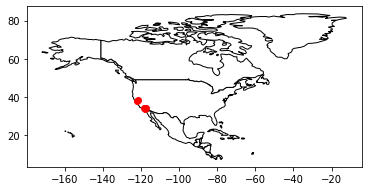

In [34]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

ax = world[world.continent == 'North America'].plot(
    color='white', edgecolor='black')
geo_cahpsa_chapters.plot(ax=ax, color='red')

In [46]:
provider_shortage = gpd.read_file('Data/provider_shortage.zip')
provider_shortages_map = provider_shortage.explore(column='DEFINITION',
                                                   cmap=colors.ListedColormap(['#D94325','#5CD925','#2672DE']),
                                                   name='Mental Healthcare Provider Shortage Areas')
interactive_map = geo_cahpsa_chapters.explore(m=provider_shortages_map, color='black', marker_type='marker',
                                              name='CaHPSA Chapters')
folium.LayerControl().add_to(interactive_map)
interactive_map

In [5]:
provider_shortage.groupby('DEFINITION').count().sort_values('FID', ascending=False).iloc[:, 0]

DEFINITION
Rural       120
Urban        48
Frontier     39
Name: FID, dtype: int64

In [6]:
provider_shortage.groupby('COUNTY').count().sort_values('FID', ascending=False).iloc[:, 0]

COUNTY
Los Angeles        14
Kern               14
San Bernardino     13
Mendocino          12
Fresno             11
San Joaquin        10
Stanislaus          9
Siskiyou            8
Butte               8
Shasta              8
Merced              6
Riverside           6
Yolo                6
Humboldt            5
Imperial            5
Lake                5
Santa Barbara       5
San Diego           4
Tehama              4
Colusa              4
Tuolumne            4
Trinity             4
Monterey            4
Sutter              3
Yuba                3
Kings               3
Modoc               3
Madera              3
Glenn               3
Contra Costa        3
Mono                2
San Luis Obispo     2
Mariposa            2
Nevada              2
Tulare              1
Calaveras           1
Ventura             1
Placer              1
Del Norte           1
El Dorado           1
Sonoma              1
Sierra              1
Alameda             1
Name: FID, dtype: int64